<h1>Table of Contents:</h1>
<ol>
    <li><b>Problem Statement</b></li>
    <li><b>Importing libraries</b></li>
    <li><b>Data Information</b></li>
    <li><b>Data Overview</b></li>
    <li><b>EDA</b></li>
    <li><b>Feature Engineering</b></li>
    <li><b>Modeling</b></li>
    <li><b>Submission</b></li>
    <li><b>Conclusion</b></li>
</ol>

## Problem statement

><b><h3>Objective</h3></b> is to predict patient's likelihood of adherence to a prescibed regimen.

## Data Information

<h3><font color='red'>Patient Information</h3></font><br>
<b>Features (Independent features):</b><br>
<ol>
    <li>Patient Id: Unique id of each patient</li>
    <li>Age:Age of patient </li>
    <li>Gender: Gender of patient</li>
    <li>Prescription period: How many days medication was prescribed for</li>
    <li>Diabetes: If patient is diabetic or not</li>
    <li>Alcoholism: If patient is alcholic or not</li>
    <li> HyperTension: If patient is hypertensive or not </li>
    <li>Smokes: If patient smokes or not </li>
    <li> Tuberculosis: If patient had tb or not </li>
    <li> Sms Reminder : How many sms reminders were sent to patient per day</li>
</ol>
<b> Target (Dependent feature):</b><br>
<ol>
    <li>Adherence: Patient adherence to prescription</li>
</ol>

## Importing libraries

In [40]:
import numpy as np 
import pandas as pd 
import os
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import warnings
warnings.filterwarnings("ignore")
import io
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff

from sklearn.model_selection import StratifiedKFold,KFold
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split

In [240]:
train = pd.read_csv('Training Data.csv')
print(train.shape)
train.head()

(180212, 11)


,patient_id,Age,Gender,Prescription_period,Diabetes,Alcoholism,HyperTension,Smokes,Tuberculosis,Sms_Reminder,Adherence
0,1,19,M,7,0,0,0,0,0,0,No
1,2,24,F,59,0,0,0,0,0,0,No
2,3,4,F,43,0,0,0,0,0,0,No
3,4,38,M,66,0,0,0,0,0,1,No
4,5,46,F,98,0,0,0,0,0,1,No


In [171]:
test = pd.read_csv('Test Data.csv')
print(test.shape)
test.head()

(119788, 10)


,patient_id,Age,Gender,Prescription_period,Diabetes,Alcoholism,HyperTension,Smokes,Tuberculosis,Sms_Reminder
0,1,5,M,28,0,0,0,0,0,1
1,2,62,F,9,1,0,1,0,0,0
2,3,4,F,73,0,0,0,0,0,1
3,4,33,M,117,0,0,0,0,0,0
4,5,38,M,8,0,0,0,0,0,1


## Data Overview

In [241]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 180212 entries, 0 to 180211
Data columns (total 11 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   patient_id           180212 non-null  int64 
 1   Age                  180212 non-null  int64 
 2   Gender               180212 non-null  object
 3   Prescription_period  180212 non-null  int64 
 4   Diabetes             180212 non-null  int64 
 5   Alcoholism           180212 non-null  int64 
 6   HyperTension         180212 non-null  int64 
 7   Smokes               180212 non-null  int64 
 8   Tuberculosis         180212 non-null  int64 
 9   Sms_Reminder         180212 non-null  int64 
 10  Adherence            180212 non-null  object
dtypes: int64(9), object(2)
memory usage: 15.1+ MB


> <b> Here we can see we data comprises of numeric and categorical feature </b>

In [11]:
print ("Rows     : " ,train.shape[0])
print ("Columns  : " ,train.shape[1])
print ("\nFeatures : \n" ,train.columns.tolist())
print ("\nMissing values :  ", train.isnull().sum().values.sum())
print ("\nUnique values :  \n",train.nunique())

Rows     :  180212
Columns  :  11

Features : 
 ['patient_id', 'Age', 'Gender', 'Prescription_period', 'Diabetes', 'Alcoholism', 'HyperTension', 'Smokes', 'Tuberculosis', 'Sms_Reminder', 'Adherence']

Missing values :   0

Unique values :  
 patient_id             180212
Age                       107
Gender                      2
Prescription_period       120
Diabetes                    2
Alcoholism                  2
HyperTension                2
Smokes                      2
Tuberculosis                2
Sms_Reminder                3
Adherence                   2
dtype: int64


> <b> Here we can see which features have number of uniques values in the data. </b>

## EDA

In [242]:
train_0 = train[train['Age']==0]

In [243]:
print(train_0.shape)
train_0.head()

(6167, 11)


,patient_id,Age,Gender,Prescription_period,Diabetes,Alcoholism,HyperTension,Smokes,Tuberculosis,Sms_Reminder,Adherence
26,27,0,M,46,0,0,0,0,0,0,No
74,75,0,F,57,0,0,0,0,0,1,No
108,109,0,F,70,0,0,0,0,0,1,No
124,125,0,F,12,0,0,0,0,0,1,Yes
188,189,0,F,119,0,0,0,0,0,1,No


In [244]:
train.describe()

,patient_id,Age,Prescription_period,Diabetes,Alcoholism,HyperTension,Smokes,Tuberculosis,Sms_Reminder
count,180212.000000,180212.000000,180212.000000,180212.000000,180212.000000,180212.000000,180212.000000,180212.000000,180212.000000
mean,90106.500000,37.795363,54.668485,0.078524,0.025043,0.216512,0.052566,0.000338,0.573968
std,52022.867693,22.852072,35.752491,0.268995,0.156255,0.411868,0.223166,0.018395,0.499824
min,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,45053.750000,19.000000,22.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,90106.500000,38.000000,51.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,135159.250000,56.000000,86.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,180212.000000,113.000000,120.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000


> <h3>Insights</h3><ol><li><b> Here we can see how are features are ranging with min,mean and max values </b><br></li>
    <li><b> We can see in the <font color='red'>Age</font> feature that minimum age is 0 and max is 113 and mean is around 37.</b><br></li>
    <li><b> Similarly we can interpret for other features too.</b></li></ol>

In [13]:
temp = train.groupby('Adherence').count().reset_index().sort_values(by='patient_id',ascending=False)
temp.style.background_gradient(cmap='Purples')

,Adherence,patient_id,Age,Gender,Prescription_period,Diabetes,Alcoholism,HyperTension,Smokes,Tuberculosis,Sms_Reminder
0,No,125822,125822,125822,125822,125822,125822,125822,125822,125822,125822
1,Yes,54390,54390,54390,54390,54390,54390,54390,54390,54390,54390


In [15]:
## Visualize the data
#labels
lab = train["Adherence"].value_counts().keys().tolist()
#values
val = train["Adherence"].value_counts().values.tolist()

trace = go.Pie(labels = lab ,
               values = val ,
               marker = dict(colors =  [ 'royalblue' ,'lime'],
                             line = dict(color = "white",
                                         width =  1.3)
                            ),
               rotation = 90,
               hoverinfo = "label+value+text",
               hole = .5
              )
layout = go.Layout(dict(title = "Target data distribution",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                       )
                  )

data = [trace]
fig = go.Figure(data = data,layout = layout)
py.iplot(fig)

> <h3>Insights</h3><ol><li><b> Here we can see Adherence features distribution which interprets as <font color='red'>Yes</font> if patient adherence to prescription and <font color='red'>No</font> if patient is not adherence to prescription</b><br></li>
    <li><b>So figure interprets that 30.2 % patient's are adherence to prescription and 69.8% not</b></li></ol>

In [17]:
### Lets draw a Funnel-Chart for better visualization

In [18]:
fig = go.Figure(go.Funnelarea(
    text=temp.Adherence,
    values=temp.patient_id,
    title={'position':'top center','text':'Funnel-chart of adherence dsitribution'}))
fig.show()

## Visualize the categorical feature data

In [19]:
train.columns

Index(['patient_id', 'Age', 'Gender', 'Prescription_period', 'Diabetes',
       'Alcoholism', 'HyperTension', 'Smokes', 'Tuberculosis', 'Sms_Reminder',
       'Adherence'],
      dtype='object')

In [21]:
#Separating churn and non churn customers
adhere     = train[train["Adherence"] == "Yes"]
not_adhere = train[train["Adherence"] == "No"]

cat_feature = ['Gender','Diabetes','Alcoholism','HyperTension','Smokes','Tuberculosis','Sms_Reminder']


#Separating catagorical and numerical columns
Id_col     = ['patient_id']
target_col = ["Adherence"]
cat_cols   = cat_feature
num_cols   = [x for x in train.columns if x not in cat_cols + target_col + Id_col]

In [245]:

for features in cat_feature:

    #labels
    lab = train[features].value_counts().keys().tolist()
    #values
    val = train[features].value_counts().values.tolist()

    trace = go.Pie(labels = lab ,
                   values = val ,
                   marker = dict(colors =  [ 'royalblue' ,'lime'],
                                 line = dict(color = "white",
                                             width =  1.3)
                                ),
                   rotation = 90,
                   hoverinfo = "label+value+text",
                   hole = .5
                  )
    layout = go.Layout(dict(title = "Categorical feature distribution: {}".format(features),
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                           )
                      )

    data = [trace]
    fig = go.Figure(data = data,layout = layout)
    py.iplot(fig)

> <h3>Insights</h3>
><ol>
    <li><b>From the figure we can interpret that in <font color='red'>Gender</font> feature more female are there as compared to male. i.e female contributes <font color='red'>66.2%</font> and male <font color='red'>33.8%</font></b></li>
    <li><b>In diabetes feature we can observe more number of patient are having diabetes i.e <font color='red'>92.1% </font> </b></li>
    <li><b>In Alcoholism feature we can observe more number of patient are alcholic i.e <font color='red'>97.5% </font> </b></li>
    <li><b>In Hypertension feature we can observe more number of patient are having hypertension i.e <font color='red'>78.3% </font> </b></li>
    <li><b>In Smokes feature we can observe more number of patient smokes i.e <font color='red'>94.7% </font> </b></li>
    <li><b>In Tuberculosis feature we can observe more number of patient are having TB i.e <font color='red'>100% </font> </b></li>
    <li><b>In SMS_reminder feature we can observe approx <font color='red'>56.9% </font> patient have sms reminder</b></li>
</ol>

In [23]:
def plot_pie(column) :
    
    trace1 = go.Pie(values  = adhere[column].value_counts().values.tolist(),
                    labels  = adhere[column].value_counts().keys().tolist(),
                    hoverinfo = "label+percent+name",
                    domain  = dict(x = [0,.48]),
                    name    = "Adherence Patients",
                    marker  = dict(line = dict(width = 2,
                                               color = "rgb(243,243,243)")
                                  ),
                    hole    = .6
                   )
    trace2 = go.Pie(values  = not_adhere[column].value_counts().values.tolist(),
                    labels  = not_adhere[column].value_counts().keys().tolist(),
                    hoverinfo = "label+percent+name",
                    marker  = dict(line = dict(width = 2,
                                               color = "rgb(243,243,243)")
                                  ),
                    domain  = dict(x = [.52,1]),
                    hole    = .6,
                    name    = "Not adherence patients" 
                   )


    layout = go.Layout(dict(title = column + " distribution in patient's feature ",
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            annotations = [dict(text = "Adherence Patients",
                                                font = dict(size = 13),
                                                showarrow = False,
                                                x = .15, y = .5),
                                           dict(text = "Non adherence patients",
                                                font = dict(size = 13),
                                                showarrow = False,
                                                x = .88,y = .5
                                               )
                                          ]
                           )
                      )
    data = [trace1,trace2]
    fig  = go.Figure(data = data,layout = layout)
    py.iplot(fig)


#function  for histogram for customer attrition types
def histogram(column) :
    trace1 = go.Histogram(x  = adhere[column],
                          histnorm= "percent",
                          name = "Adherence Patient's",
                          marker = dict(line = dict(width = .5,
                                                    color = "black"
                                                    )
                                        ),
                         opacity = .9 
                         ) 
    
    trace2 = go.Histogram(x  = not_adhere[column],
                          histnorm = "percent",
                          name = "Non adherence patients",
                          marker = dict(line = dict(width = .5,
                                              color = "black"
                                             )
                                 ),
                          opacity = .9
                         )
    
    data = [trace1,trace2]
    layout = go.Layout(dict(title =column + " distribution in patients features ",
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = column,
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                            yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = "percent",
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                           )
                      )
    fig  = go.Figure(data=data,layout=layout)
    
    py.iplot(fig)
    
# #function  for scatter plot matrix  for numerical columns in data
def scatter_matrix(df)  :
    
    df  = df.sort_values(by = "Adherence" ,ascending = True)
    classes = df["Adherence"].unique().tolist()
    classes
    
    class_code  = {classes[k] : k for k in range(2)}
    class_code

    color_vals = [class_code[cl] for cl in df["Adherence"]]
    color_vals

    pl_colorscale = "Portland"

    pl_colorscale

    text = [df.loc[k,"Adherence"] for k in range(len(df))]
    text

    trace = go.Splom(dimensions = [dict(label  = "Age",
                                       values = df["Age"]),
                                  dict(label  = 'Prescription_period',
                                       values = df['Prescription_period'])],
                     text = text,
                     marker = dict(color = color_vals,
                                   colorscale = pl_colorscale,
                                   size = 3,
                                   showscale = False,
                                   line = dict(width = .1,
                                               color='rgb(230,230,230)'
                                              )
                                  )
                    )
    axis = dict(showline  = True,
                zeroline  = False,
                gridcolor = "#fff",
                ticklen   = 4
               )
    
    layout = go.Layout(dict(title  = 
                            "Scatter plot matrix for Numerical columns for customer attrition",
                            autosize = False,
                            height = 800,
                            width  = 800,
                            dragmode = "select",
                            hovermode = "closest",
                            plot_bgcolor  = 'rgba(240,240,240, 0.95)',
                            xaxis1 = dict(axis),
                            yaxis1 = dict(axis),
                            xaxis2 = dict(axis),
                            yaxis2 = dict(axis),
                            xaxis3 = dict(axis),
                            yaxis3 = dict(axis),
                           )
                      )
    data   = [trace]
    fig = go.Figure(data = data,layout = layout )
    py.iplot(fig)

#for all categorical columns plot pie
for i in cat_feature :
    plot_pie(i)

#for all categorical columns plot histogram    
for i in num_cols :
    histogram(i)
    
scatter_matrix(train)

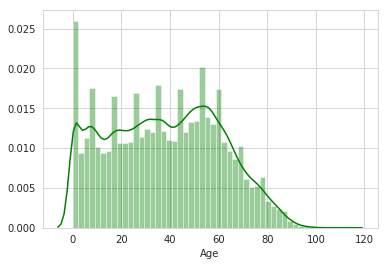

In [33]:
sns.distplot(train['Age'], color='g', bins=50, hist_kws={'alpha': 0.4});

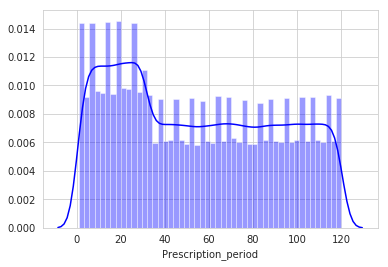

In [31]:
sns.distplot(train['Prescription_period'], color='b', bins=50, hist_kws={'alpha': 0.4});

## Feature Engineering

In [274]:
## getting features from prescription period i.e Week and Year

def _get_weeks_(number_of_days):
    week = int((number_of_days % 365) / 7)
    
    return week

def _get_years(number_of_days):
    year = int(number_of_days / 365)
    
    return year

In [250]:
train['Prescription_period_week'] = train['Prescription_period'].apply(lambda x: _get_weeks_(x))
train['Prescription_period_year'] = train['Prescription_period'].apply(lambda x: _get_years(x))

In [258]:
train['Gender']=train['Gender'].map({'F':0,'M':1})

In [259]:
train['Adherence']=train['Adherence'].map({'No':1,'Yes':0})

In [276]:
X = train.drop(['patient_id','Adherence'],axis=1)

## Co-relation Matrix

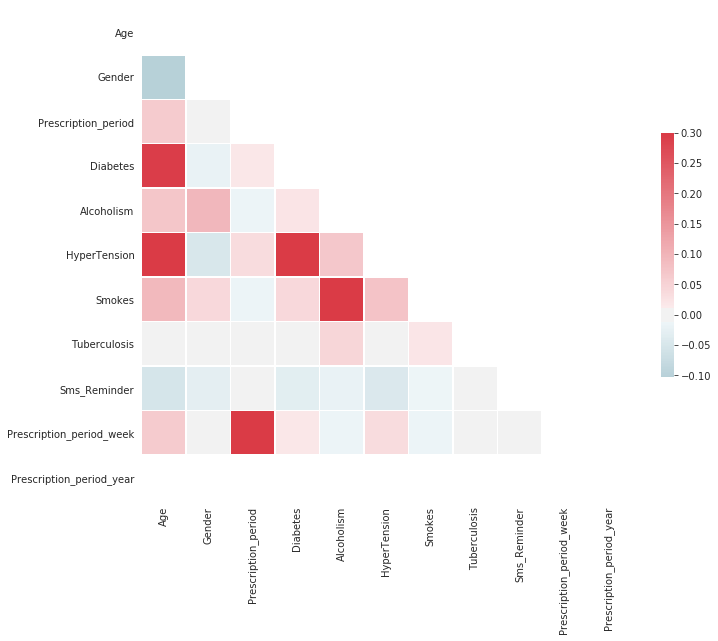

In [288]:
corr = X.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=np.bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

> <b>Here we can see our features are not coorelated to each other.</b>

In [278]:
# Target class
Y = train['Adherence']

In [279]:
# Splitting data into train and test with test size of 0.2
xtrain,xtest,ytrain,ytest = train_test_split(X,Y,test_size=0.2,stratify=Y,random_state=10)

## Modeling

In [264]:
def _get_confusion_matrix(df):
    cf_matrix = pd.DataFrame(conf_matrix,["Positive","Negative"],
                        ["Positive","Negative"],
                         dtype=int)
    sns.heatmap(cf_matrix,annot=True,annot_kws={"size": 16}, fmt='g')
    plt.title('Confusion Matrix')
    
    print('Classification Report\n',classification_report(prediction,ytest))
    
    
    print("Precision for Yes :{}%".format((df[0][0])*100/(df[0][0]+df[0][1])))
    print("Recall for Yes : {}%".format((df[0][0])*100/(df[0][0]+df[1][0])))
    print("Precision for No : {}%".format((df[1][1])*100/(df[1][1]+df[1][0])))
    print("Recall for No : {}%".format((df[1][1])*100/(df[1][1]+df[0][1])))

## LGBM

In [280]:
model = LGBMClassifier(learning_rate=0.02,
                    boosting_type='gbdt',
                    max_depth=4,
                    random_state=100,
                    n_estimators=800,
                    reg_alpha=0,
                    reg_lambda=1,
                    n_jobs=-1)
model.fit(X,Y)
model.fit(xtrain,ytrain)
prediction = model.predict(xtest)
print("Accuraccy score",accuracy_score(prediction,ytest))
co_matrix = confusion_matrix(prediction,ytest)

Accuraccy score 0.8964015204061815


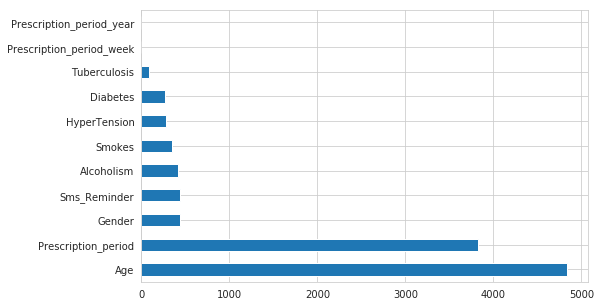

In [281]:
# Let's the feature importances
feat_imp = pd.Series(model.feature_importances_, index=X.columns)
feat_imp.nlargest(30).plot(kind='barh', figsize=(8,5))

Classification Report
               precision    recall  f1-score   support

           0       0.89      0.79      0.84     12316
           1       0.90      0.95      0.92     23727

   micro avg       0.90      0.90      0.90     36043
   macro avg       0.90      0.87      0.88     36043
weighted avg       0.90      0.90      0.89     36043

Precision for Yes :79.00292302695681%
Recall for Yes : 89.44658944658944%
Precision for No : 95.16163021030893%
Recall for No : 89.72382276971985%


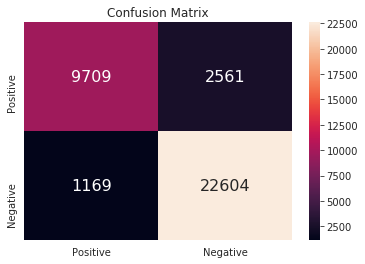

In [267]:
_get_confusion_matrix(co_matrix)

## Randomforest

In [43]:
from sklearn.model_selection import GridSearchCV

n_estimators = [50,100]
max_depth = [3,5, 8, 15]
min_samples_split = [2, 5, 10, 15]
min_samples_leaf = [1, 2, 5, 10] 

forest = RandomForestClassifier()

hyperF = dict(n_estimators = n_estimators, max_depth = max_depth,  
              min_samples_split = min_samples_split, 
             min_samples_leaf = min_samples_leaf)

gridF = GridSearchCV(forest, hyperF, cv = 3, verbose = 1, 
                      n_jobs = 6)
bestF = gridF.fit(xtrain, ytrain)

Fitting 3 folds for each of 128 candidates, totalling 384 fits


[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jobs=6)]: Done  38 tasks      | elapsed:   40.8s
[Parallel(n_jobs=6)]: Done 188 tasks      | elapsed:  3.6min
[Parallel(n_jobs=6)]: Done 384 out of 384 | elapsed:  9.4min finished


In [44]:
bestF.best_estimator_

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=8, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=10, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=50, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [282]:
from sklearn.metrics import accuracy_score,f1_score,confusion_matrix,classification_report

model = RandomForestClassifier(max_depth=8,min_samples_leaf=1,min_samples_split=10,n_estimators=50)
model.fit(xtrain,ytrain)
prediction = model.predict(xtest)
print("Accuraccy score",accuracy_score(prediction,ytest))
co_matrix = confusion_matrix(prediction,ytest)

Accuraccy score 0.8964292650445301


Classification Report
               precision    recall  f1-score   support

           0       0.90      0.79      0.84     12369
           1       0.90      0.95      0.92     23674

   micro avg       0.90      0.90      0.90     36043
   macro avg       0.90      0.87      0.88     36043
weighted avg       0.90      0.90      0.89     36043

Precision for Yes :78.88269059746139%
Recall for Yes : 89.69479683765398%
Precision for No : 95.26484751203853%
Recall for No : 89.62050466918339%


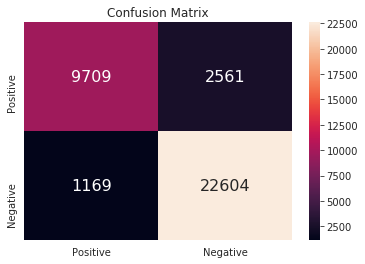

In [283]:
_get_confusion_matrix(co_matrix)

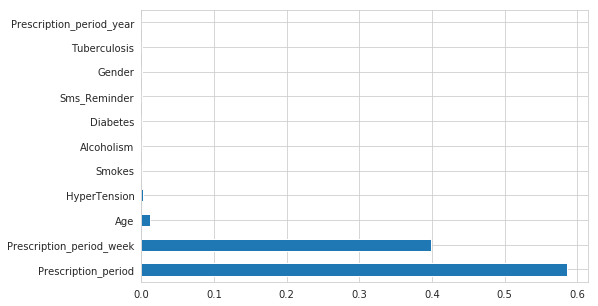

In [284]:
# Let's the feature importances
feat_imp = pd.Series(model.feature_importances_, index=xtrain.columns)
feat_imp.nlargest(30).plot(kind='barh', figsize=(8,5))

## Xgboost

In [123]:
from sklearn.model_selection import GridSearchCV
import xgboost as xgb

n_estimators = [50,100,300]
max_depth = [3,5, 8, 15]
learning_rate = [0.001,0.01,0.1,1]

xgb_model = xgb.XGBClassifier(
                      scale_pos_weight=1,
                      colsample_bytree = 0.4,
                      subsample = 0.8,
                      objective='binary:logistic', 
                      reg_alpha = 0.3, 
                      gamma=10)

hyperF = dict(n_estimators = n_estimators, max_depth = max_depth,learning_rate=learning_rate)

gridF = GridSearchCV(xgb_model, hyperF, cv = 3, verbose = 1, 
                      n_jobs = 6)
bestF = gridF.fit(xtrain, ytrain)

Fitting 3 folds for each of 48 candidates, totalling 144 fits


[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jobs=6)]: Done  38 tasks      | elapsed:   53.4s
[Parallel(n_jobs=6)]: Done 144 out of 144 | elapsed:  3.9min finished


In [124]:
bestF.best_estimator_

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bynode=1, colsample_bytree=0.4, gamma=10, gpu_id=-1,
       importance_type='gain', interaction_constraints='', learning_rate=1,
       max_delta_step=0, max_depth=8, min_child_weight=1, missing=nan,
       monotone_constraints='()', n_estimators=300, n_jobs=0,
       num_parallel_tree=1, objective='binary:logistic', random_state=0,
       reg_alpha=0.3, reg_lambda=1, scale_pos_weight=1, subsample=0.8,
       tree_method='exact', validate_parameters=1, verbosity=None)

In [285]:
model = xgb.XGBClassifier( 
                      scale_pos_weight=1,
                      learning_rate=1,  
                      colsample_bytree = 0.4,
                      subsample = 0.8,
                      objective='binary:logistic', 
                      n_estimators=300, 
                      reg_alpha = 0.3,
                      max_depth=5, 
                      gamma=10)

model.fit(xtrain,ytrain)
prediction = model.predict(xtest)
print("Accuraccy score",accuracy_score(prediction,ytest))
co_matrix = confusion_matrix(prediction,ytest)

Accuraccy score 0.8967622007047138


Classification Report
               precision    recall  f1-score   support

           0       0.90      0.79      0.84     12341
           1       0.90      0.95      0.92     23702

   micro avg       0.90      0.90      0.90     36043
   macro avg       0.90      0.87      0.88     36043
weighted avg       0.90      0.90      0.90     36043

Precision for Yes :78.99683980228507%
Recall for Yes : 89.62125390696819%
Precision for No : 95.23668888701376%
Recall for No : 89.69998013113451%


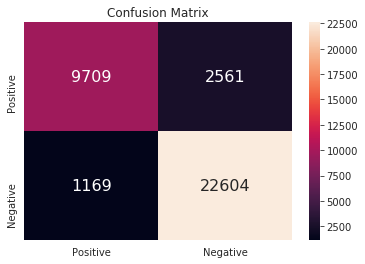

In [286]:
_get_confusion_matrix(co_matrix)

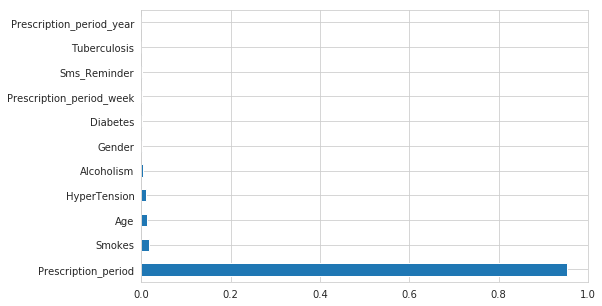

In [287]:
# Let's the feature importances
feat_imp = pd.Series(model.feature_importances_, index=xtrain.columns)
feat_imp.nlargest(30).plot(kind='barh', figsize=(8,5))

## Logistic Regression

In [224]:
xtrain,xtest,ytrain,ytest = train_test_split(final,Y,test_size=0.2,stratify=Y,random_state=10)

In [209]:
sc = StandardScaler()

In [206]:
train_numeric = train[['Age','Prescription_period']]

In [217]:
train_cat = X.drop(['Age','Prescription_period'],axis=1)

In [208]:
train_numeric = sc.fit_transform(train_numeric)

In [222]:
final = np.hstack((np.array(train_cat),train_numeric))

In [231]:
from sklearn.model_selection import GridSearchCV
from math import log
from sklearn.linear_model import LogisticRegression

K = [10**-4, 10**-2, 10**0, 10**2, 10**4]

Model= LogisticRegression()
parameters = [{'C': [10**-4, 10**-2, 10**0, 10**2, 10**4]}]  
gsv = GridSearchCV(Model,parameters,cv=3,verbose=1,scoring = 'roc_auc' , n_jobs=6)
gsv.fit(xtrain,ytrain)
gsv.best_estimator_

Fitting 3 folds for each of 5 candidates, totalling 15 fits


[Parallel(n_jobs=6)]: Using backend LokyBackend with 6 concurrent workers.
[Parallel(n_jobs=6)]: Done  15 out of  15 | elapsed:    2.7s finished


LogisticRegression(C=1, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=None, solver='warn',
          tol=0.0001, verbose=0, warm_start=False)

In [232]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
from sklearn.metrics import roc_curve, auc

model = LogisticRegression(C=1, penalty='l2')
model.fit(xtrain, ytrain)
prediction = model.predict(xtest)

print("Accuraccy score",accuracy_score(prediction,ytest))
co_matrix = confusion_matrix(prediction,ytest)

Accuraccy score 0.8820297977415864


Classification Report
               precision    recall  f1-score   support

           0       0.82      0.79      0.81     11320
           1       0.91      0.92      0.91     24723

   micro avg       0.88      0.88      0.88     36043
   macro avg       0.87      0.86      0.86     36043
weighted avg       0.88      0.88      0.88     36043

Precision for Yes :79.26678445229682%
Recall for Yes : 82.48758963044678%
Precision for No : 92.2946244387817%
Recall for No : 90.67355454003577%


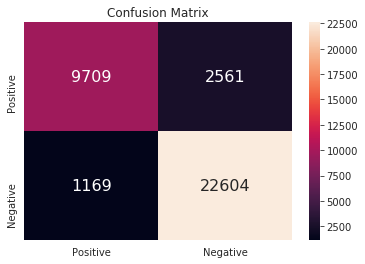

In [233]:
_get_confusion_matrix(co_matrix)

## Testing with best model

In [295]:
test.head()

,patient_id,Age,Gender,Prescription_period,Diabetes,Alcoholism,HyperTension,Smokes,Tuberculosis,Sms_Reminder,Prescription_period_week,Prescription_period_year
0,1,5,1,28,0,0,0,0,0,1,4,0
1,2,62,0,9,1,0,1,0,0,0,1,0
2,3,4,0,73,0,0,0,0,0,1,10,0
3,4,33,1,117,0,0,0,0,0,0,16,0
4,5,38,1,8,0,0,0,0,0,1,1,0


In [291]:
test['Gender']=test['Gender'].map({'F':0,'M':1})

In [292]:
test['Prescription_period_week'] = test['Prescription_period'].apply(lambda x: _get_weeks_(x))
test['Prescription_period_year'] = test['Prescription_period'].apply(lambda x: _get_years(x))

In [293]:
prediction_prob = model.predict_proba(test.drop('patient_id',axis=1))[:, 1]

In [294]:
adherence_ = [ 'Yes' if x>=0.5 else 'No' for x in prediction_prob]

## Submission

In [296]:
result = pd.DataFrame()
result['patient_id']=test['patient_id']
result['adherence'] = adherence_
result['probability_score']= prediction_prob

# saving csv to local

result.to_csv('result.csv',index=None)

In [297]:
result.head()

,patient_id,adherence,probability_score
0,1,No,0.193075
1,2,No,0.232508
2,3,Yes,0.949358
3,4,Yes,0.937048
4,5,No,0.200523


## Model Comparision

In [298]:
from prettytable import PrettyTable
x = PrettyTable()
x.field_names = ["Models","Accuracy","Recall","precision"]

x.add_row(["logistic",88.20,88,88])
x.add_row(["lgm",89.64,90,90])
x.add_row(["Randomfores",89.64,90,90])
x.add_row(["Xgboost",89.67,90,90])

print(x)

+-------------+----------+--------+-----------+
|    Models   | Accuracy | Recall | precision |
+-------------+----------+--------+-----------+
|   logistic  |   88.2   |   88   |     88    |
|     lgm     |  89.64   |   90   |     90    |
| Randomfores |  89.64   |   90   |     90    |
|   Xgboost   |  89.67   |   90   |     90    |
+-------------+----------+--------+-----------+


## Conclusion

> <b>With Xgboost we got approx more accuaccy as compared to other model but we are having same precison and recall.</b>